<a href="https://colab.research.google.com/github/maximum4645/ComputerVision/blob/main/object_detection_v5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Dataset

In [10]:
import torch
import torchvision
import torchvision.transforms as T
from torch.utils.data import random_split, Subset
import torchvision.transforms.functional as F
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
from google.colab.patches import cv2_imshow
import shutil
import os
import random

In [2]:
# Define the transform
transform = T.Compose([T.ToTensor()])

# Download the dataset
dataset = torchvision.datasets.VOCDetection(root='.', year='2012', image_set='trainval', download=True, transform=transform)

# Use just a fraction of the dataset
# Use 1 for the whole dataset
fraction = 0.4

# Get a list of indices and shuffle them
indices = list(range(len(dataset)))
random.shuffle(indices)

# Select a subset of indices
subset_indices = indices[:int(len(indices) * fraction)]

# Create the subset dataset
subset_dataset = Subset(dataset, subset_indices)

# Split the subset into train and test sets
train_size = int(0.8 * len(subset_dataset))
test_size = len(subset_dataset) - train_size
train_set, test_set = random_split(subset_dataset, [train_size, test_size])

print('Number of train set :', len(train_set))
print('Number of test set :', len(test_set))

import xml.etree.ElementTree as ET

def extract_classes_from_voc_annotations(annotations_path):
    classes = set()
    for annotation_file in os.listdir(annotations_path):
        if annotation_file.endswith('.xml'):
            tree = ET.parse(os.path.join(annotations_path, annotation_file))
            root = tree.getroot()
            for obj in root.findall('object'):
                class_name = obj.find('name').text
                classes.add(class_name)
    return sorted(classes)

annotations_path = '/content/VOCdevkit/VOC2012/Annotations'
class_names = extract_classes_from_voc_annotations(annotations_path)
class_names

Using downloaded and verified file: ./VOCtrainval_11-May-2012.tar
Extracting ./VOCtrainval_11-May-2012.tar to .
Number of train set : 3692
Number of test set : 924


['aeroplane',
 'bicycle',
 'bird',
 'boat',
 'bottle',
 'bus',
 'car',
 'cat',
 'chair',
 'cow',
 'diningtable',
 'dog',
 'horse',
 'motorbike',
 'person',
 'pottedplant',
 'sheep',
 'sofa',
 'train',
 'tvmonitor']

# Model : YOLOv8

In [3]:
!pip install ultralytics
!pip install opencv-python
!pip install tensorboard

In [4]:
from ultralytics import YOLO
import copy

# Load a pretrained YOLO model
model_1 = YOLO('yolov8n.pt')  # or yolov8s.pt, yolov8m.pt, yolov8l.pt, yolov8x.pt
model_before_training = copy.deepcopy(model_1)
model_before_training

YOLO(
  (model): DetectionModel(
    (model): Sequential(
      (0): Conv(
        (conv): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(16, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (1): Conv(
        (conv): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(32, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (2): C2f(
        (cv1): Conv(
          (conv): Conv2d(32, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn): BatchNorm2d(32, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
          (act): SiLU(inplace=True)
        )
        (cv2): Conv(
          (conv): Conv2d(48, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn): BatchNorm2d(32, eps=0.001, momentum=0.03, affine=True, track_running_s

## Converting to YOLO format

In [5]:
images_path = './VOCdevkit/VOC2012/JPEGImages'
annotations_path = './VOCdevkit/VOC2012/Annotations'
train_path = './VOCdevkit/VOC2012/train'
val_path = './VOCdevkit/VOC2012/val'

# Create directories if they don't exist
os.makedirs(train_path, exist_ok=True)
os.makedirs(val_path, exist_ok=True)

In [6]:
import os
import shutil
import xml.etree.ElementTree as ET

def format_yolo(dataset, indices, img_src_dir, annotations_src_dir, dest_dir):
    os.makedirs(dest_dir, exist_ok=True)
    for e in dataset:

        img_filename = e[1]['annotation']['filename']
        voc_annotation_filename = img_filename.replace('.jpg', '.xml')

        img_path = os.path.join(img_src_dir, img_filename)
        annotations_path = os.path.join(annotations_src_dir, voc_annotation_filename)

        # Copy the image file
        shutil.copy(img_path, dest_dir)

        tree = ET.parse(annotations_path)
        root = tree.getroot()

        width = int(root.find('size/width').text)
        height = int(root.find('size/height').text)

        # Create the YOLO formatted annotation file
        txt_filename = voc_annotation_filename.replace('.xml', '.txt')
        txt_path = os.path.join(dest_dir, txt_filename)
        with open(txt_path, 'w') as f:
            for obj in root.findall('object'):
                label = obj.find('name').text
                if label in class_names:
                    label_idx = class_names.index(label)
                    bbox = obj.find('bndbox')
                    x_min = int(float(bbox.find('xmin').text))
                    y_min = int(float(bbox.find('ymin').text))
                    x_max = int(float(bbox.find('xmax').text))
                    y_max = int(float(bbox.find('ymax').text))

                    x_center = (x_min + x_max) / 2 / width
                    y_center = (y_min + y_max) / 2 / height
                    bbox_width = (x_max - x_min) / width
                    bbox_height = (y_max - y_min) / height

                    f.write(f"{label_idx} {x_center} {y_center} {bbox_width} {bbox_height}\n")

# Train set
train_indices = [subset_indices[i] for i in train_set.indices]
format_yolo(train_set, train_indices, images_path, annotations_path, train_path)

# Test set
test_indices = [subset_indices[i] for i in test_set.indices]
format_yolo(test_set, test_indices, images_path, annotations_path, val_path)

# Check if correctly done
print('Number of files in train :', len(os.listdir(train_path)))
print('Number of files in val :', len(os.listdir(val_path)))

# Data paths
# Define the content of the data.yaml file
data_yaml_content = f"""
train: /content/VOCdevkit/VOC2012/train
val: /content/VOCdevkit/VOC2012/val

nc: {len(class_names)}  # Number of classes
names: {class_names}
"""

# Write the content to a file
with open('data.yaml', 'w') as file:
    file.write(data_yaml_content)

# Verify the content
!cat data.yaml

Number of files in train : 12374
Number of files in val : 3552

train: /content/VOCdevkit/VOC2012/train
val: /content/VOCdevkit/VOC2012/val

nc: 20  # Number of classes
names: ['aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus', 'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike', 'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tvmonitor']


# Prediction

## Evaluation before training

In [7]:
import time

start_time = time.time()

results_before = model_1.val(data='data.yaml')

end_time = time.time()

total_time = end_time - start_time
print(f"Validation time before training: {total_time:.2f} seconds")

print(list(results_before.names.values()))
print()
print(results_before.results_dict)
print()
print(results_before.speed)

Ultralytics YOLOv8.2.73 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8n summary (fused): 168 layers, 3,151,904 parameters, 0 gradients, 8.7 GFLOPs


val: Scanning /content/VOCdevkit/VOC2012/val... 1776 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1776/1776 [00:01<00:00, 1693.15it/s]

val: New cache created: /content/VOCdevkit/VOC2012/val.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 111/111 [00:25<00:00,  4.31it/s]


                   all       1776       4831      0.186     0.0776     0.0859     0.0688
                person        106        171          0          0   0.000103   5.96e-05
               bicycle         78         99      0.819      0.734      0.812      0.606
                   car        116        167          0          0   0.000126   5.03e-05
            motorcycle         81        172          0          0   0.000985   0.000496
              airplane        123        237          0          0    0.00034   0.000194
                   bus         73        106      0.898      0.811      0.864      0.739
                 train        213        411          0          0     0.0145     0.0117
                 truck        177        202          0          0   0.000301    0.00013
                  boat        189        367          0          0    0.00053   0.000431
         traffic light         46        112          0          0          0          0
          fire hydran

Confusion Matrix shape: (81, 81)
Number of classes: 80
Number of classes: 81


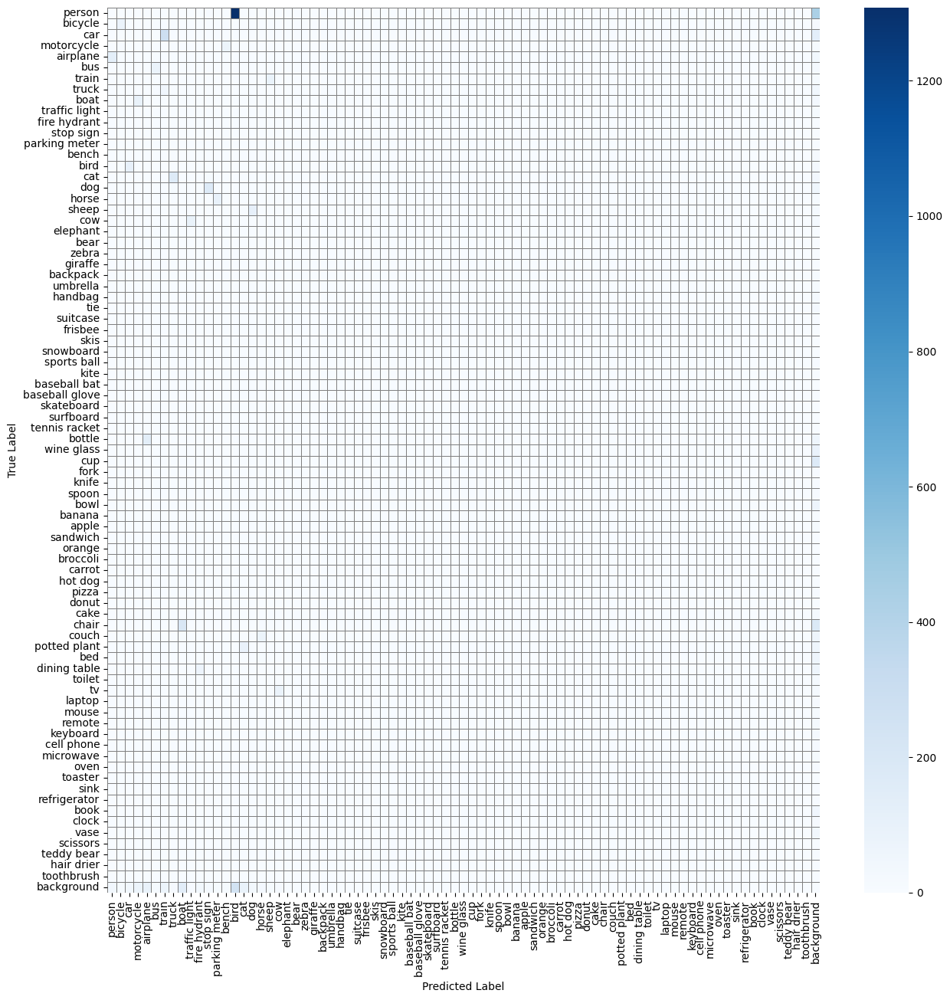

In [8]:
confusion_matrix = results_before.confusion_matrix.matrix
print("Confusion Matrix shape:", confusion_matrix.shape)
classes = list(results_before.names.values())
print("Number of classes:", len(classes))
if 'background' not in classes:
    classes.append('background')
print("Number of classes:", len(classes))

plt.figure(figsize=(15, 15))
sns.heatmap(confusion_matrix, annot=False, fmt='d', cmap='Blues',
            xticklabels=classes, yticklabels=classes, linewidths=0.5, linecolor='gray')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.xticks(rotation=90)
plt.show()

## Visualization before training


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_007383.jpg: 544x640 1 train, 30.2ms
Speed: 5.3ms preprocess, 30.2ms inference, 2.3ms postprocess per image at shape (1, 3, 544, 640)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_007383.jpg: 544x640 1 train, 33.3ms
Speed: 3.2ms preprocess, 33.3ms inference, 2.1ms postprocess per image at shape (1, 3, 544, 640)
Displaying results before training:


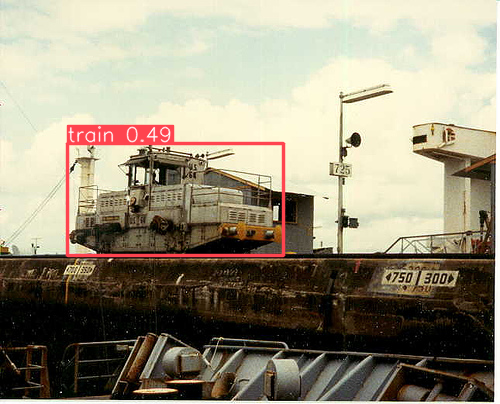

Displaying results after training:


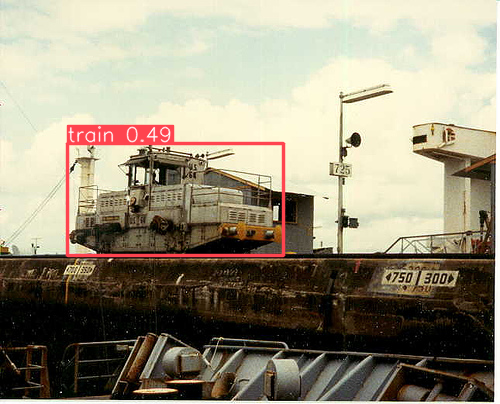


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_001488.jpg: 448x640 2 persons, 26.2ms
Speed: 3.1ms preprocess, 26.2ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_001488.jpg: 448x640 2 persons, 13.2ms
Speed: 2.7ms preprocess, 13.2ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)
Displaying results before training:


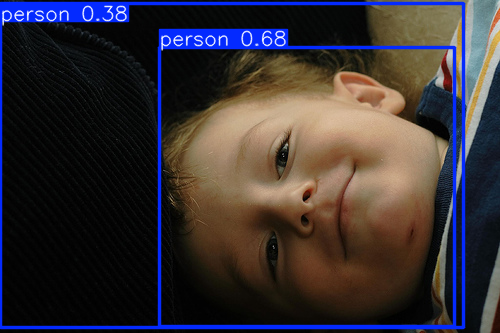

Displaying results after training:


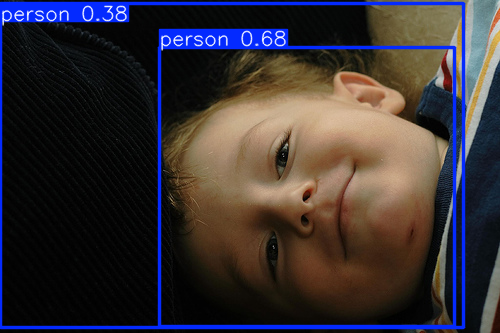


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_002682.jpg: 640x480 1 cat, 10.6ms
Speed: 3.5ms preprocess, 10.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_002682.jpg: 640x480 1 cat, 12.9ms
Speed: 2.7ms preprocess, 12.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)
Displaying results before training:


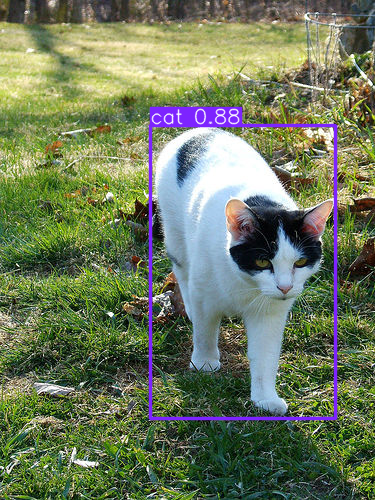

Displaying results after training:


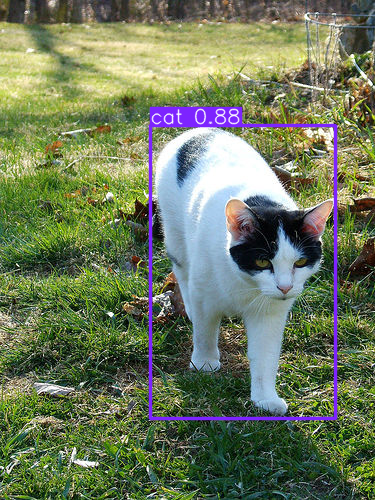


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_004347.jpg: 640x480 1 cat, 11.3ms
Speed: 8.3ms preprocess, 11.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_004347.jpg: 640x480 1 cat, 8.1ms
Speed: 2.7ms preprocess, 8.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)
Displaying results before training:


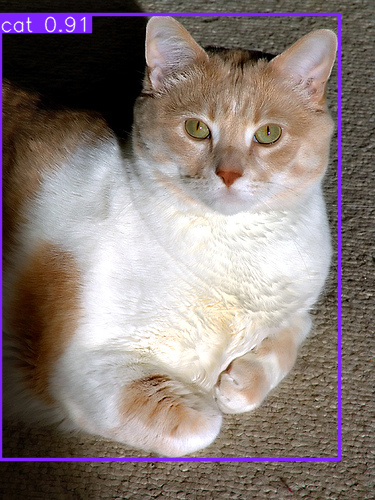

Displaying results after training:


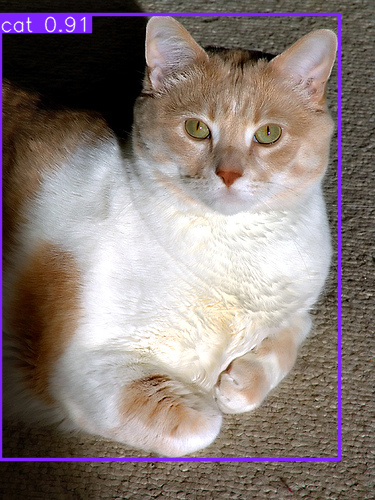


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2009_003157.jpg: 640x448 5 chairs, 1 couch, 1 potted plant, 1 tv, 13.9ms
Speed: 2.6ms preprocess, 13.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 448)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2009_003157.jpg: 640x448 5 chairs, 1 couch, 1 potted plant, 1 tv, 10.9ms
Speed: 2.6ms preprocess, 10.9ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 448)
Displaying results before training:


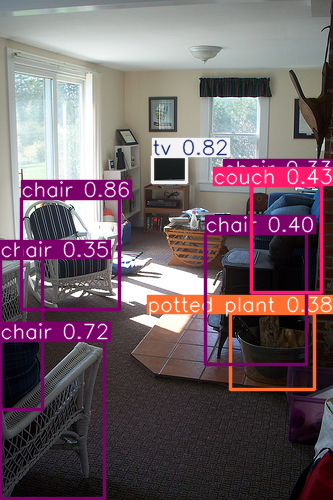

Displaying results after training:


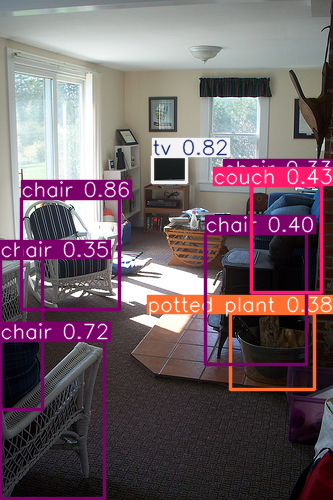


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2010_001456.jpg: 640x480 3 persons, 1 boat, 23.2ms
Speed: 3.1ms preprocess, 23.2ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2010_001456.jpg: 640x480 3 persons, 1 boat, 13.1ms
Speed: 2.7ms preprocess, 13.1ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 480)
Displaying results before training:


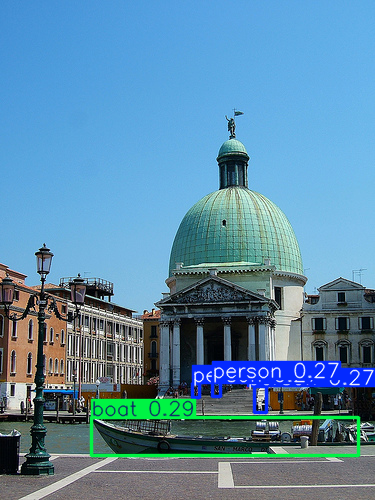

Displaying results after training:


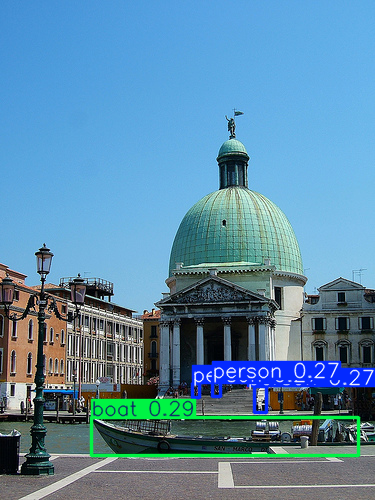


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_002778.jpg: 480x640 1 cow, 10.8ms
Speed: 3.4ms preprocess, 10.8ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_002778.jpg: 480x640 1 cow, 11.7ms
Speed: 2.8ms preprocess, 11.7ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
Displaying results before training:


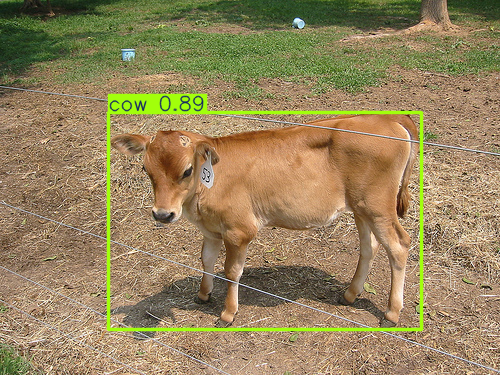

Displaying results after training:


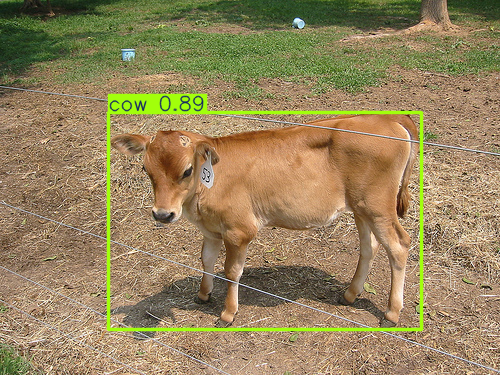


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_004797.jpg: 640x480 1 bench, 1 cat, 11.0ms
Speed: 3.0ms preprocess, 11.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_004797.jpg: 640x480 1 bench, 1 cat, 9.3ms
Speed: 3.0ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)
Displaying results before training:


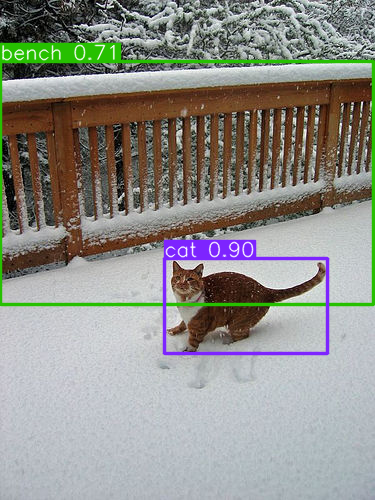

Displaying results after training:


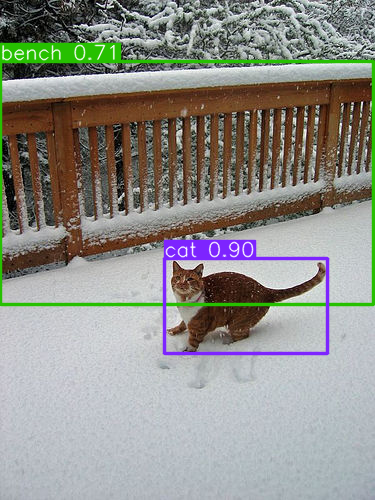


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_005812.jpg: 480x640 1 person, 1 bottle, 14.0ms
Speed: 5.6ms preprocess, 14.0ms inference, 3.4ms postprocess per image at shape (1, 3, 480, 640)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_005812.jpg: 480x640 1 person, 1 bottle, 9.7ms
Speed: 2.7ms preprocess, 9.7ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
Displaying results before training:


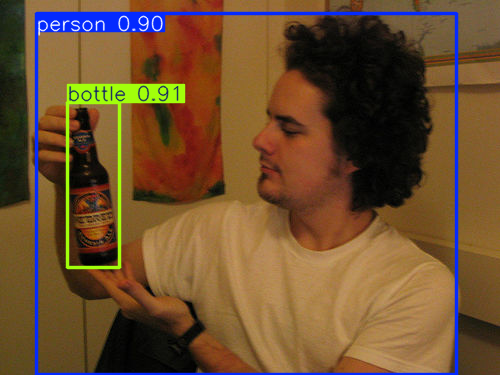

Displaying results after training:


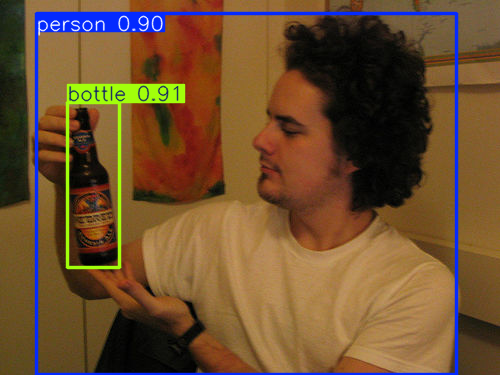


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2009_001653.jpg: 640x448 1 dog, 10.4ms
Speed: 2.9ms preprocess, 10.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 448)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2009_001653.jpg: 640x448 1 dog, 10.3ms
Speed: 2.5ms preprocess, 10.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 448)
Displaying results before training:


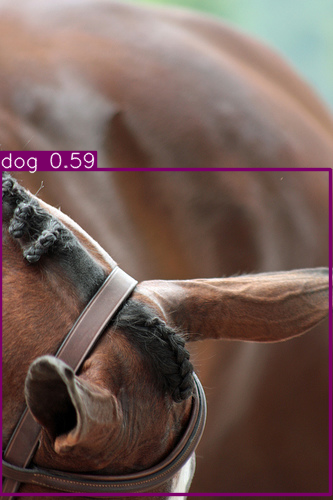

Displaying results after training:


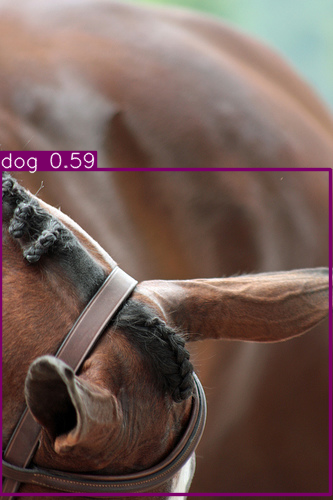

In [18]:
import cv2
from google.colab.patches import cv2_imshow

def compare_models(model_before, model_after, image_paths):
    for img_path in image_paths:
        # Predict with the model before training
        results_before = model_before.predict(img_path)
        img_before = results_before[0].plot()

        # Predict with the model after training
        results_after = model_after.predict(img_path)
        img_after = results_after[0].plot()

        # Display using OpenCV
        print("Displaying results before training:")
        cv2_imshow(img_before)
        cv2.waitKey(0)  # Wait for a key press to close the image window

        print("Displaying results after training:")
        cv2_imshow(img_after)
        cv2.waitKey(0)  # Wait for a key press to close the image window

    cv2.destroyAllWindows()

# Prepare a list of image paths for validation
sample_image_paths = []
for i in range(10):
    img_info = test_set[i]
    img_path = img_info[1]['annotation']['filename']
    full_img_path = os.path.join('/content/VOCdevkit/VOC2012/JPEGImages', img_path)
    sample_image_paths.append(full_img_path)

# Compare the models
compare_models(model_before_training, model_1, sample_image_paths)



image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_007383.jpg: 544x640 1 train, 12.6ms
Speed: 2.9ms preprocess, 12.6ms inference, 2.0ms postprocess per image at shape (1, 3, 544, 640)
Results before training for /content/VOCdevkit/VOC2012/JPEGImages/2008_007383.jpg:
ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bot

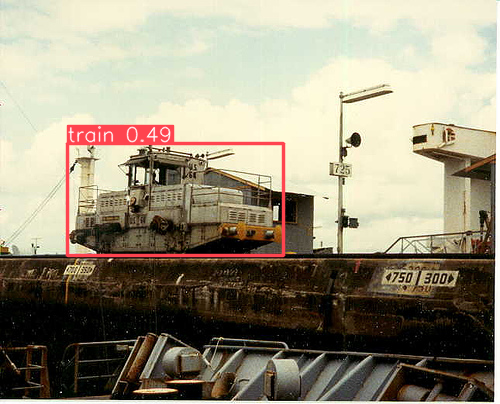

Displaying results after training:


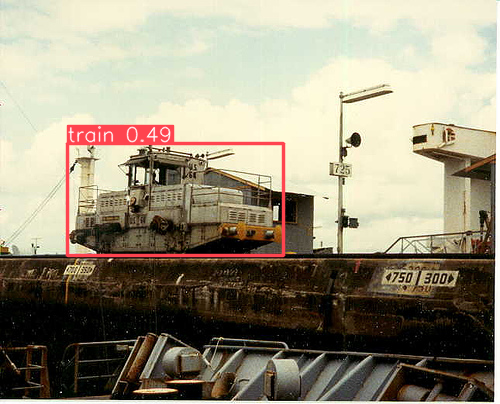


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_001488.jpg: 448x640 2 persons, 10.1ms
Speed: 2.9ms preprocess, 10.1ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Results before training for /content/VOCdevkit/VOC2012/JPEGImages/2008_001488.jpg:
ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'b

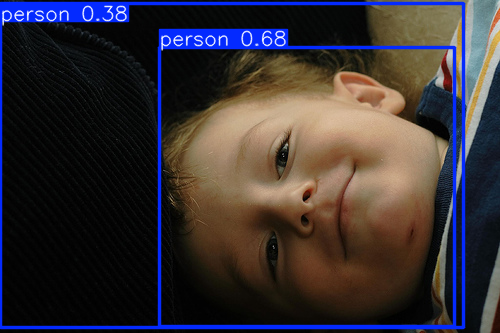

Displaying results after training:


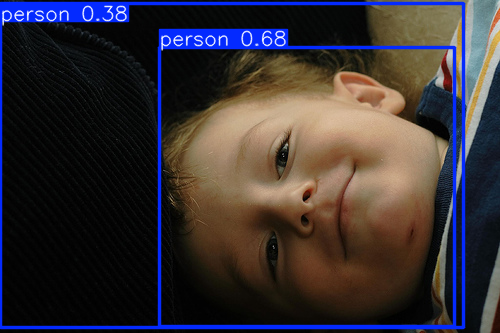


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_002682.jpg: 640x480 1 cat, 11.8ms
Speed: 3.1ms preprocess, 11.8ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 480)
Results before training for /content/VOCdevkit/VOC2012/JPEGImages/2008_002682.jpg:
ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottl

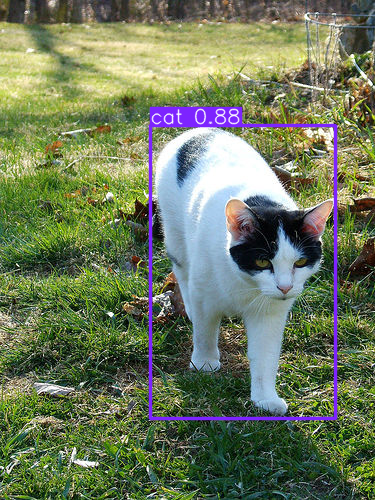

Displaying results after training:


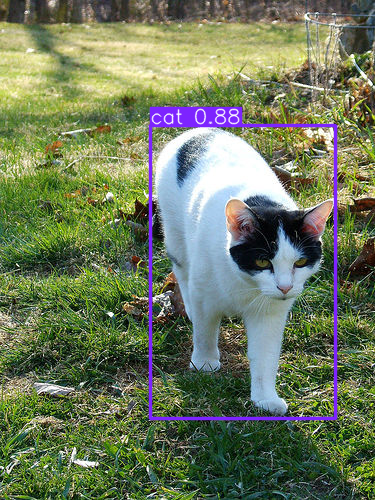


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_004347.jpg: 640x480 1 cat, 13.2ms
Speed: 2.8ms preprocess, 13.2ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)
Results before training for /content/VOCdevkit/VOC2012/JPEGImages/2008_004347.jpg:
ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottl

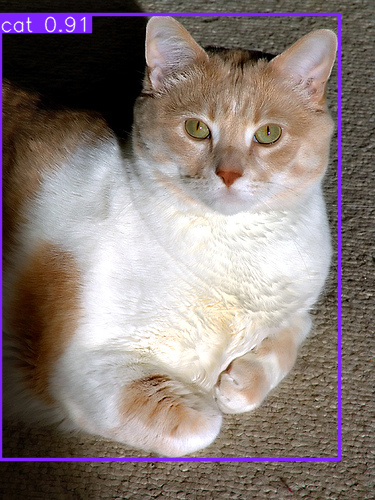

Displaying results after training:


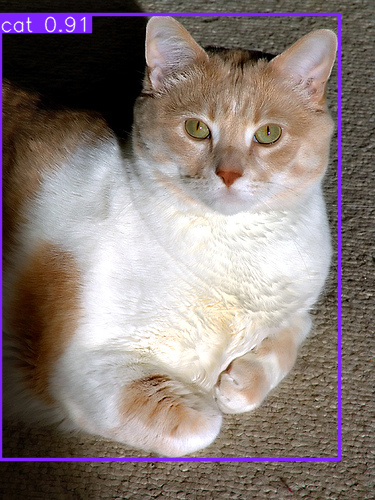


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2009_003157.jpg: 640x448 5 chairs, 1 couch, 1 potted plant, 1 tv, 9.6ms
Speed: 3.0ms preprocess, 9.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 448)
Results before training for /content/VOCdevkit/VOC2012/JPEGImages/2009_003157.jpg:
ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard',

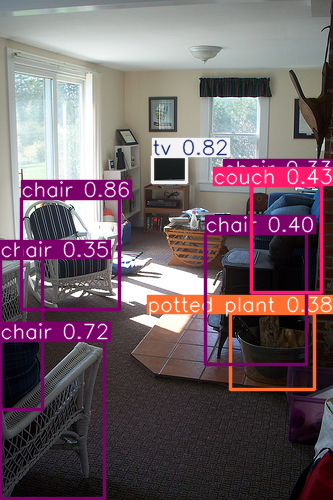

Displaying results after training:


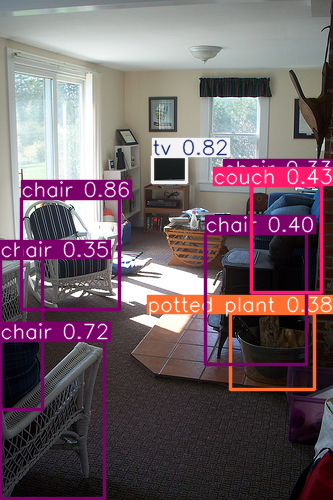


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2010_001456.jpg: 640x480 3 persons, 1 boat, 10.9ms
Speed: 6.4ms preprocess, 10.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)
Results before training for /content/VOCdevkit/VOC2012/JPEGImages/2010_001456.jpg:
ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket'

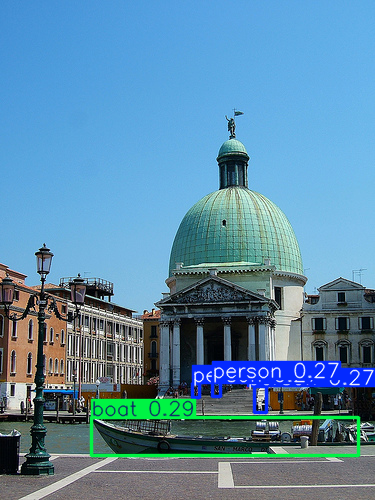

Displaying results after training:


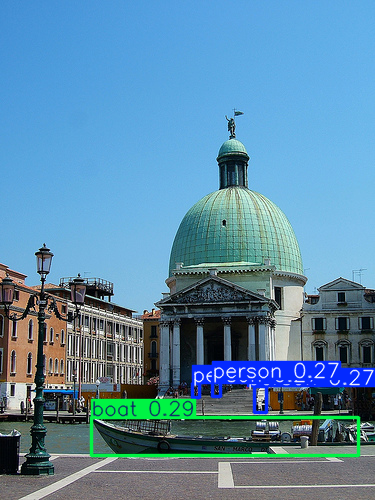


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_002778.jpg: 480x640 1 cow, 15.1ms
Speed: 7.0ms preprocess, 15.1ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)
Results before training for /content/VOCdevkit/VOC2012/JPEGImages/2008_002778.jpg:
ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottl

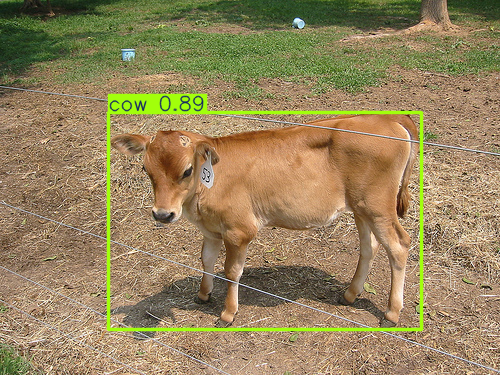

Displaying results after training:


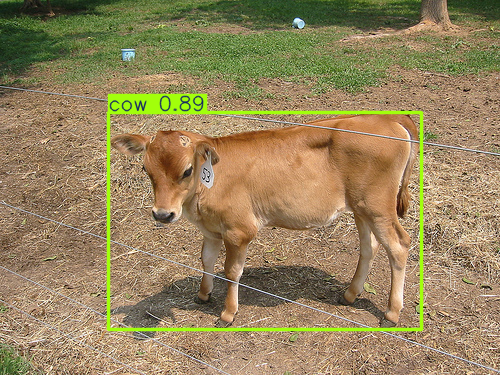


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_004797.jpg: 640x480 1 bench, 1 cat, 12.8ms
Speed: 2.9ms preprocess, 12.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 480)
Results before training for /content/VOCdevkit/VOC2012/JPEGImages/2008_004797.jpg:
ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 3

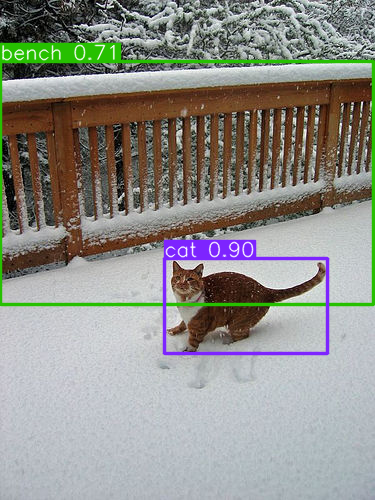

Displaying results after training:


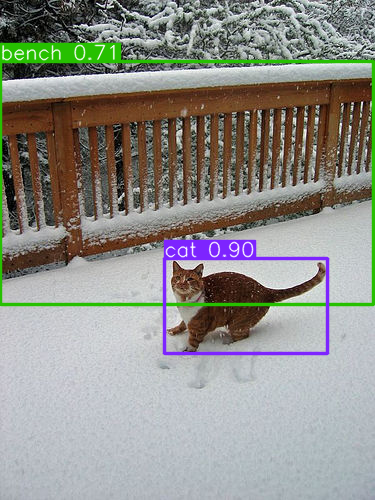


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_005812.jpg: 480x640 1 person, 1 bottle, 17.0ms
Speed: 3.0ms preprocess, 17.0ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)
Results before training for /content/VOCdevkit/VOC2012/JPEGImages/2008_005812.jpg:
ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket

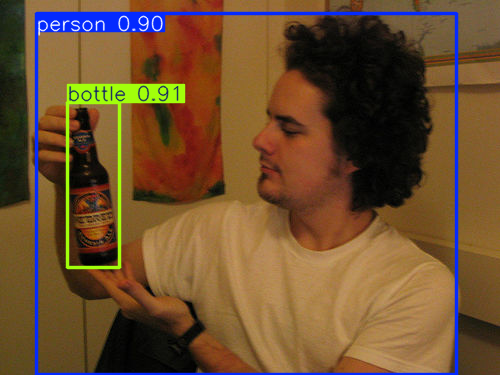

Displaying results after training:


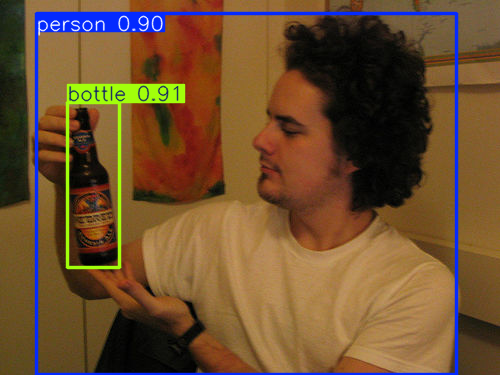


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2009_001653.jpg: 640x448 1 dog, 16.4ms
Speed: 2.8ms preprocess, 16.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 448)
Results before training for /content/VOCdevkit/VOC2012/JPEGImages/2009_001653.jpg:
ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottl

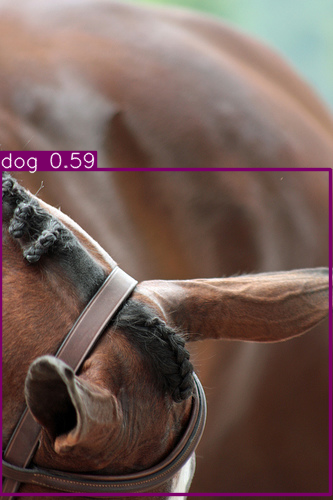

Displaying results after training:


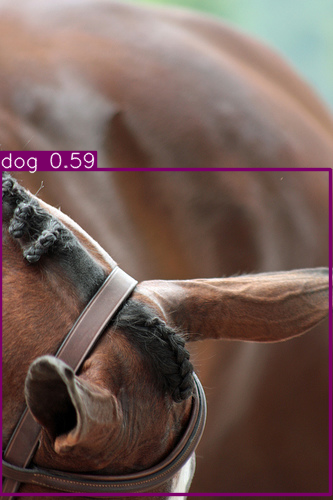

In [19]:
def compare_models_verbose(model_before, model_after, image_paths):
    for img_path in image_paths:
        # Predict with the model before training
        results_before = model_before.predict(img_path)
        img_before = results_before[0].plot()
        print(f"Results before training for {img_path}:")
        print(results_before[0])

        # Predict with the model after training
        results_after = model_after.predict(img_path)
        img_after = results_after[0].plot()
        print(f"Results after training for {img_path}:")
        print(results_after[0])

        # Display using OpenCV
        print("Displaying results before training:")
        cv2_imshow(img_before)
        cv2.waitKey(0)  # Wait for a key press to close the image window

        print("Displaying results after training:")
        cv2_imshow(img_after)
        cv2.waitKey(0)  # Wait for a key press to close the image window

    cv2.destroyAllWindows()

# Compare the models with detailed output
compare_models_verbose(model_before_training, model_1, sample_image_paths)

In [20]:
def compare_state_dicts(model_before, model_after):
    state_dict_before = model_before.model.state_dict()
    state_dict_after = model_after.model.state_dict()

    for key in state_dict_before:
        if not torch.equal(state_dict_before[key], state_dict_after[key]):
            print(f"Parameter {key} has changed.")
        else:
            print(f"Parameter {key} is unchanged.")

# Compare the state_dicts
compare_state_dicts(model_before_training, model_1)

Parameter model.0.conv.weight has changed.
Parameter model.0.conv.bias has changed.
Parameter model.1.conv.weight has changed.
Parameter model.1.conv.bias has changed.
Parameter model.2.cv1.conv.weight has changed.
Parameter model.2.cv1.conv.bias has changed.
Parameter model.2.cv2.conv.weight has changed.
Parameter model.2.cv2.conv.bias has changed.
Parameter model.2.m.0.cv1.conv.weight has changed.
Parameter model.2.m.0.cv1.conv.bias has changed.
Parameter model.2.m.0.cv2.conv.weight has changed.
Parameter model.2.m.0.cv2.conv.bias has changed.
Parameter model.3.conv.weight has changed.
Parameter model.3.conv.bias has changed.
Parameter model.4.cv1.conv.weight has changed.
Parameter model.4.cv1.conv.bias has changed.
Parameter model.4.cv2.conv.weight has changed.
Parameter model.4.cv2.conv.bias has changed.
Parameter model.4.m.0.cv1.conv.weight has changed.
Parameter model.4.m.0.cv1.conv.bias has changed.
Parameter model.4.m.0.cv2.conv.weight has changed.
Parameter model.4.m.0.cv2.con


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_007383.jpg: 544x640 1 train, 11.6ms
Speed: 2.7ms preprocess, 11.6ms inference, 1.9ms postprocess per image at shape (1, 3, 544, 640)


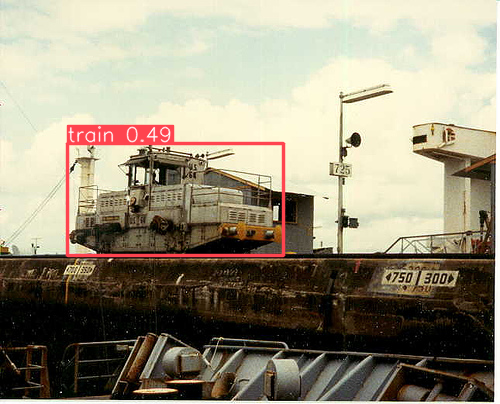


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_001488.jpg: 448x640 2 persons, 101.0ms
Speed: 4.6ms preprocess, 101.0ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


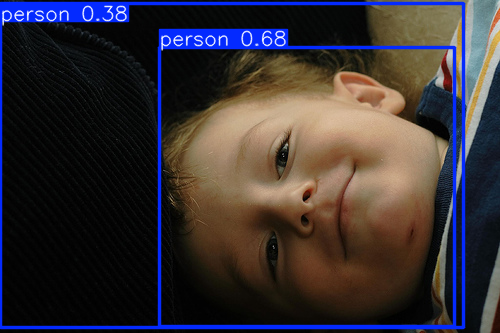


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_002682.jpg: 640x480 1 cat, 141.1ms
Speed: 3.3ms preprocess, 141.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)


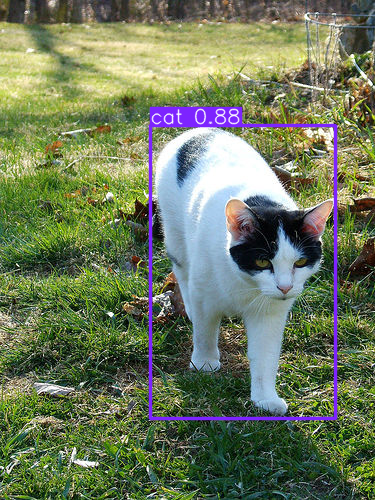


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_004347.jpg: 640x480 1 cat, 11.8ms
Speed: 3.2ms preprocess, 11.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)


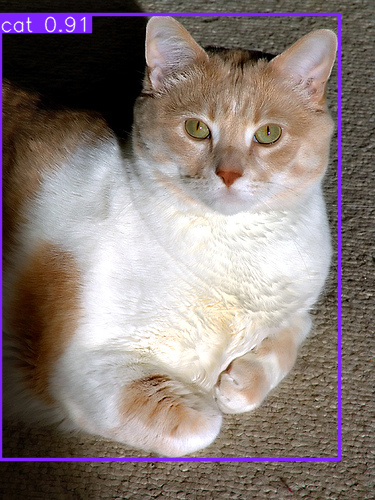


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2009_003157.jpg: 640x448 5 chairs, 1 couch, 1 potted plant, 1 tv, 130.7ms
Speed: 2.6ms preprocess, 130.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 448)


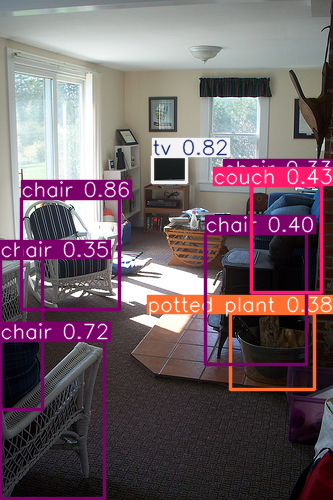


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2010_001456.jpg: 640x480 3 persons, 1 boat, 14.5ms
Speed: 2.7ms preprocess, 14.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)


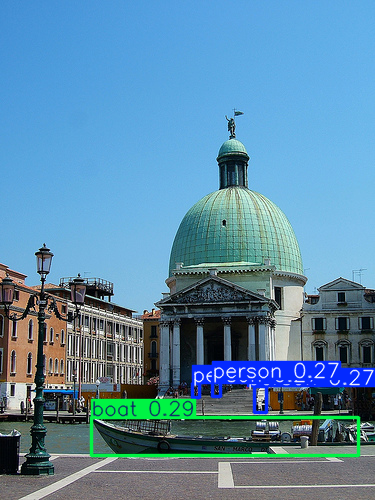


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_002778.jpg: 480x640 1 cow, 124.5ms
Speed: 2.7ms preprocess, 124.5ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


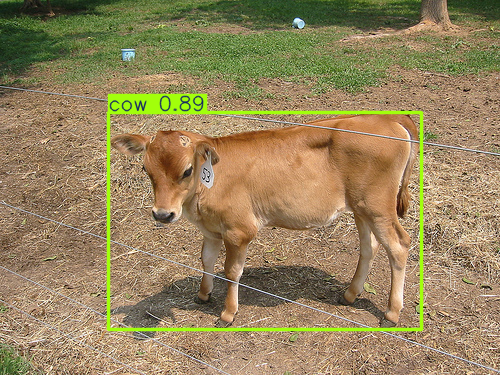


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_004797.jpg: 640x480 1 bench, 1 cat, 16.6ms
Speed: 7.5ms preprocess, 16.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)


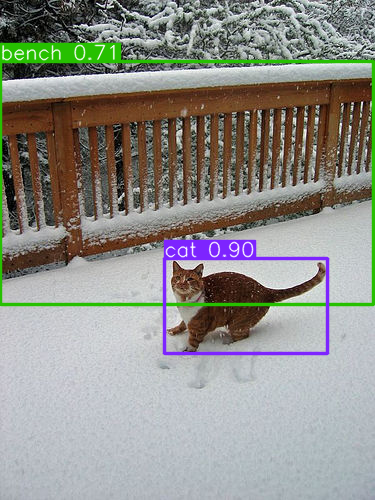


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_005812.jpg: 480x640 1 person, 1 bottle, 9.0ms
Speed: 2.9ms preprocess, 9.0ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


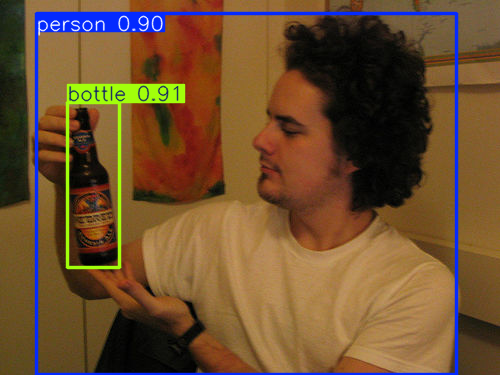


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2009_001653.jpg: 640x448 1 dog, 9.3ms
Speed: 2.8ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 448)


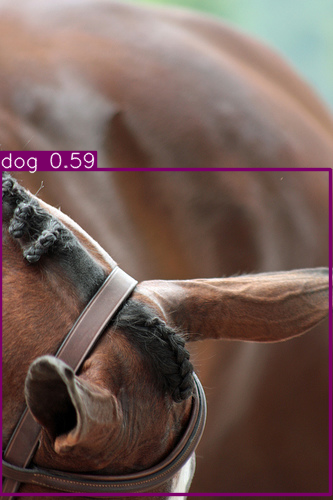

In [11]:
sample_image_paths = []
for i in range(10):
    img_info = test_set[i]
    img_path = img_info[1]['annotation']['filename']
    full_img_path = os.path.join('/content/VOCdevkit/VOC2012/JPEGImages', img_path)
    sample_image_paths.append(full_img_path)

# Predict and visualize using the simplified method
for img_path in sample_image_paths:
    # Predict and get results
    results = model_1.predict(img_path)

    # Plot and display the results
    img = results[0].plot()

    # Display using OpenCV
    cv2_imshow(img)
    cv2.waitKey(0)  # Wait for a key press to close the image window
    cv2.destroyAllWindows()

## Training

In [12]:
start_time = time.time()

# Train the model with TensorBoard logging
model_1.train(data='data.yaml', epochs=10, imgsz=640, project='runs/train', name='exp', workers=2)

end_time = time.time()

total_time = end_time - start_time
print(f"Total training time: {total_time:.2f} seconds")

Ultralytics YOLOv8.2.73 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=2, project=runs/train, name=exp3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, 

train: Scanning /content/VOCdevkit/VOC2012/train... 6187 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6187/6187 [00:03<00:00, 1753.90it/s]


train: New cache created: /content/VOCdevkit/VOC2012/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/VOCdevkit/VOC2012/val.cache... 1776 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1776/1776 [00:00<?, ?it/s]


Plotting labels to runs/train/exp3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000417, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/train/exp3
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      2.34G      2.154      4.082      2.188         31        640: 100%|██████████| 387/387 [02:28<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:22<00:00,  2.46it/s]


                   all       1776       4831      0.396      0.244      0.216      0.126

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      2.36G      1.508      2.856      1.696         42        640: 100%|██████████| 387/387 [02:12<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:18<00:00,  2.97it/s]


                   all       1776       4831      0.497      0.413      0.419      0.264

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      2.36G      1.339      2.368      1.559         32        640: 100%|██████████| 387/387 [02:13<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:18<00:00,  3.05it/s]


                   all       1776       4831      0.618      0.464      0.506      0.334

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      2.39G      1.258      2.067       1.48         62        640: 100%|██████████| 387/387 [02:13<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:18<00:00,  3.09it/s]


                   all       1776       4831       0.66      0.497      0.559      0.377

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      2.35G        1.2      1.868      1.439         28        640: 100%|██████████| 387/387 [02:10<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:18<00:00,  3.04it/s]


                   all       1776       4831      0.683      0.531      0.595       0.41

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      2.36G      1.147       1.72      1.393         35        640: 100%|██████████| 387/387 [02:16<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:17<00:00,  3.14it/s]


                   all       1776       4831       0.72      0.537      0.625       0.44

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      2.36G      1.116      1.619      1.369         21        640: 100%|██████████| 387/387 [02:01<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:17<00:00,  3.19it/s]


                   all       1776       4831      0.742      0.554      0.649      0.464

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      2.35G      1.089      1.525      1.349         35        640: 100%|██████████| 387/387 [02:10<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:20<00:00,  2.68it/s]


                   all       1776       4831      0.742      0.576      0.667      0.478

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      2.37G      1.079      1.482      1.337         28        640: 100%|██████████| 387/387 [02:03<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:17<00:00,  3.24it/s]


                   all       1776       4831      0.763      0.582      0.678      0.492

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      2.35G       1.05      1.426      1.321         39        640: 100%|██████████| 387/387 [02:10<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:17<00:00,  3.17it/s]


                   all       1776       4831      0.723      0.609      0.686        0.5

10 epochs completed in 0.423 hours.
Optimizer stripped from runs/train/exp3/weights/last.pt, 6.2MB
Optimizer stripped from runs/train/exp3/weights/best.pt, 6.2MB

Validating runs/train/exp3/weights/best.pt...
Ultralytics YOLOv8.2.73 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,009,548 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:22<00:00,  2.50it/s]


                   all       1776       4831      0.722      0.609      0.686        0.5
             aeroplane        106        171      0.877      0.626      0.718      0.521
               bicycle         78         99      0.744      0.646      0.757      0.549
                  bird        116        167      0.772      0.473      0.616      0.417
                  boat         81        172      0.625       0.43      0.487      0.328
                bottle        123        237      0.641      0.447      0.504      0.352
                   bus         73        106      0.769      0.717      0.768      0.667
                   car        213        411      0.806      0.689      0.763      0.542
                   cat        177        202      0.825      0.767      0.864      0.651
                 chair        189        367      0.564      0.395      0.458      0.305
                   cow         46        112      0.671      0.732      0.754      0.551
           diningtabl

## Evaluation after training

In [14]:
import time

start_time = time.time()

results_after = model_1.val(data='data.yaml')

end_time = time.time()

total_time = end_time - start_time
print(f"Validation time after training: {total_time:.2f} seconds")

print(list(results_after.names.values()))
print()
print(results_after.results_dict)
print()
print(results_after.speed)

Ultralytics YOLOv8.2.73 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,009,548 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/VOCdevkit/VOC2012/val.cache... 1776 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1776/1776 [00:00<?, ?it/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 111/111 [00:28<00:00,  3.91it/s]


                   all       1776       4831      0.724      0.609      0.685        0.5
             aeroplane        106        171      0.876      0.622      0.721      0.519
               bicycle         78         99      0.749      0.657       0.76      0.552
                  bird        116        167      0.767      0.473      0.614      0.413
                  boat         81        172       0.62      0.424      0.483      0.327
                bottle        123        237      0.653      0.447      0.506      0.352
                   bus         73        106      0.771      0.717      0.767      0.665
                   car        213        411      0.809      0.689      0.763      0.542
                   cat        177        202      0.828      0.767      0.864       0.65
                 chair        189        367      0.566      0.392      0.456      0.305
                   cow         46        112       0.67      0.732      0.752       0.55
           diningtabl

Confusion Matrix shape: (21, 21)
Number of classes: 20
Number of classes: 21


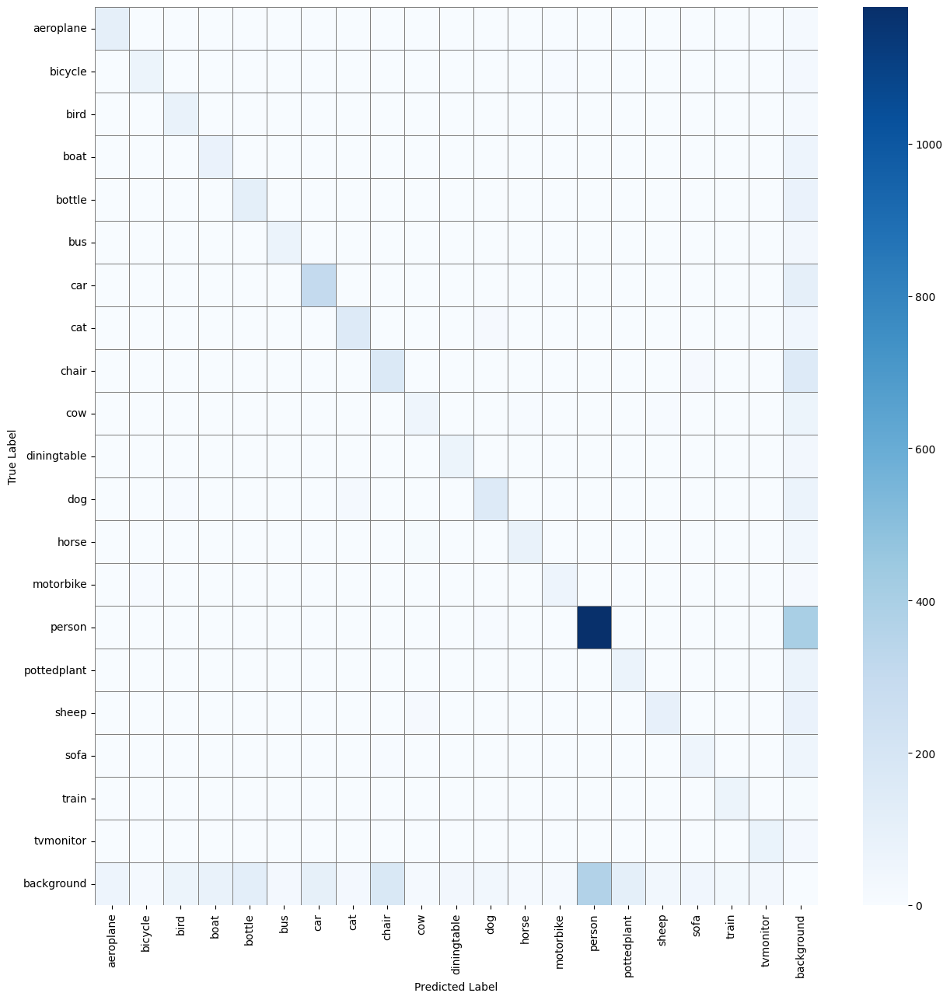

In [15]:
confusion_matrix = results_after.confusion_matrix.matrix
print("Confusion Matrix shape:", confusion_matrix.shape)
classes = list(results_after.names.values())
print("Number of classes:", len(classes))
if 'background' not in classes:
    classes.append('background')
print("Number of classes:", len(classes))

plt.figure(figsize=(15, 15))
sns.heatmap(confusion_matrix, annot=False, fmt='d', cmap='Blues',
            xticklabels=classes, yticklabels=classes, linewidths=0.5, linecolor='gray')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.xticks(rotation=90)
plt.show()

## Visualization after training


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_007383.jpg: 544x640 1 train, 200.4ms
Speed: 3.1ms preprocess, 200.4ms inference, 2.6ms postprocess per image at shape (1, 3, 544, 640)


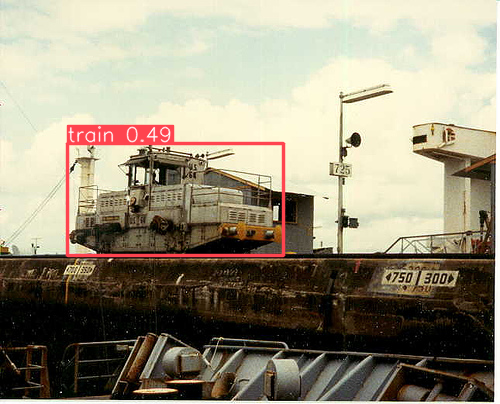


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_001488.jpg: 448x640 2 persons, 131.9ms
Speed: 4.6ms preprocess, 131.9ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)


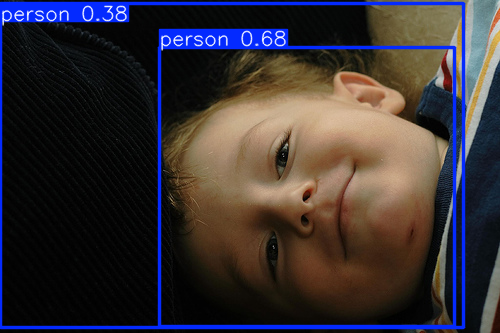


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_002682.jpg: 640x480 1 cat, 15.0ms
Speed: 3.0ms preprocess, 15.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 480)


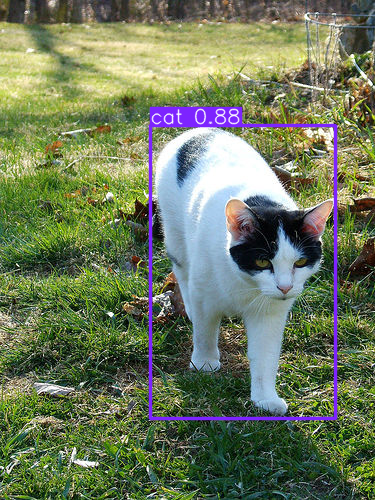


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_004347.jpg: 640x480 1 cat, 42.6ms
Speed: 7.6ms preprocess, 42.6ms inference, 11.2ms postprocess per image at shape (1, 3, 640, 480)


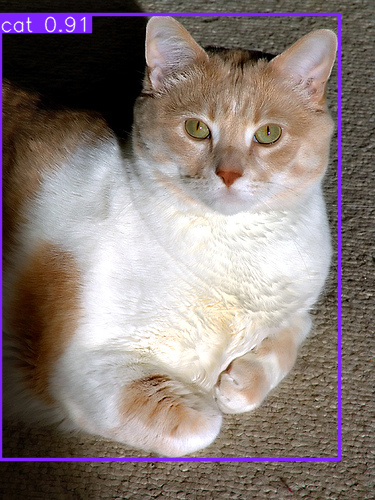


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2009_003157.jpg: 640x448 5 chairs, 1 couch, 1 potted plant, 1 tv, 143.6ms
Speed: 2.8ms preprocess, 143.6ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 448)


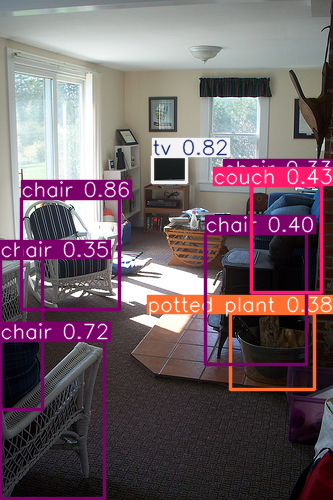


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2010_001456.jpg: 640x480 3 persons, 1 boat, 10.6ms
Speed: 3.8ms preprocess, 10.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)


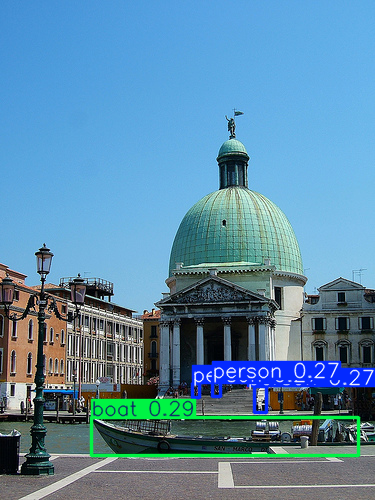


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_002778.jpg: 480x640 1 cow, 121.2ms
Speed: 2.7ms preprocess, 121.2ms inference, 2.3ms postprocess per image at shape (1, 3, 480, 640)


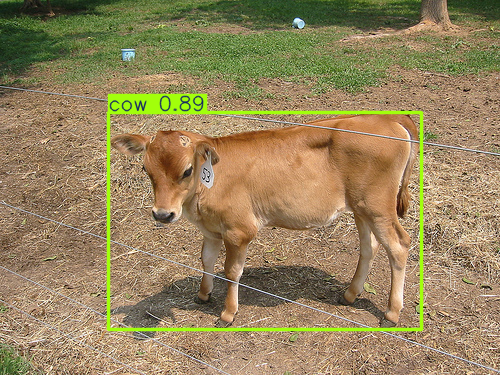


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_004797.jpg: 640x480 1 bench, 1 cat, 10.0ms
Speed: 3.1ms preprocess, 10.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)


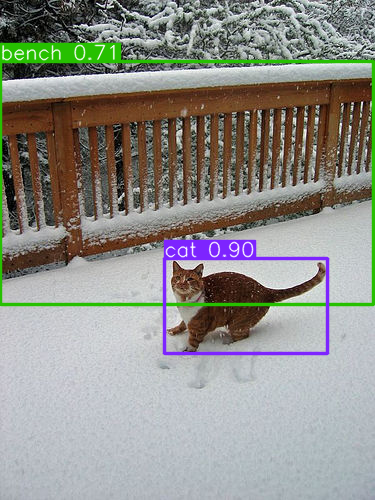


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_005812.jpg: 480x640 1 person, 1 bottle, 10.3ms
Speed: 2.8ms preprocess, 10.3ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


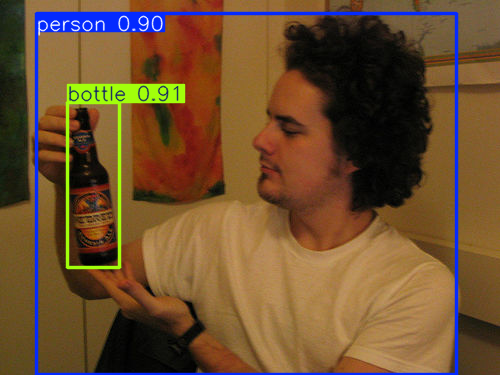


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2009_001653.jpg: 640x448 1 dog, 10.1ms
Speed: 2.6ms preprocess, 10.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 448)


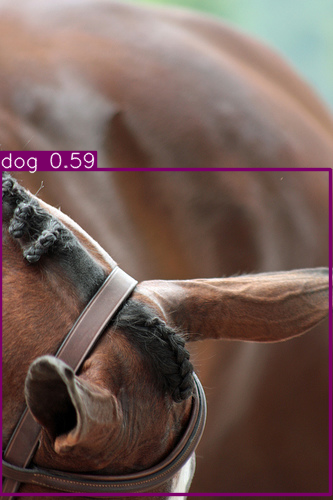

In [16]:
sample_image_paths = []
for i in range(10):
    img_info = test_set[i]
    img_path = img_info[1]['annotation']['filename']
    full_img_path = os.path.join('/content/VOCdevkit/VOC2012/JPEGImages', img_path)
    sample_image_paths.append(full_img_path)

# Predict and visualize using the simplified method
for img_path in sample_image_paths:
    # Predict and get results
    results = model_1.predict(img_path)

    # Plot and display the results
    img = results[0].plot()

    # Display using OpenCV
    cv2_imshow(img)
    cv2.waitKey(0)  # Wait for a key press to close the image window
    cv2.destroyAllWindows()


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_007383.jpg: 544x640 1 train, 32.6ms
Speed: 3.3ms preprocess, 32.6ms inference, 2.5ms postprocess per image at shape (1, 3, 544, 640)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_007383.jpg: 544x640 1 train, 12.3ms
Speed: 2.1ms preprocess, 12.3ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)
Displaying results before training:


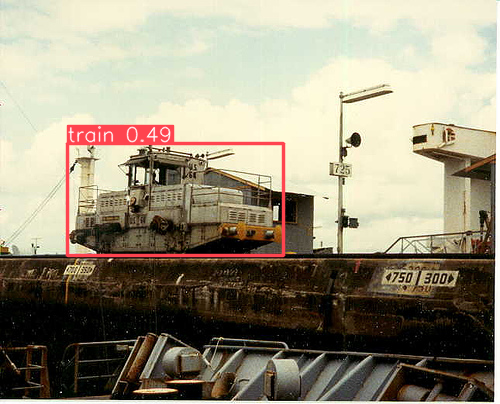

Displaying results after training:


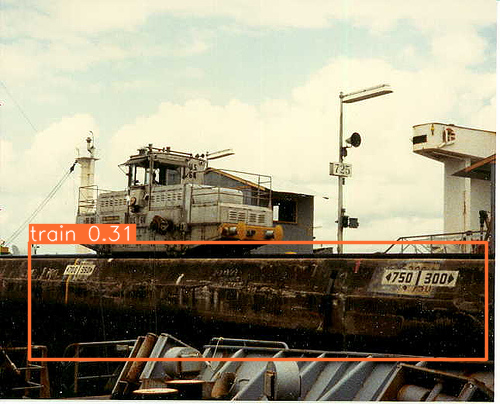


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_001488.jpg: 448x640 2 persons, 10.6ms
Speed: 2.9ms preprocess, 10.6ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_001488.jpg: 448x640 1 cat, 21.1ms
Speed: 4.8ms preprocess, 21.1ms inference, 1.8ms postprocess per image at shape (1, 3, 448, 640)
Displaying results before training:


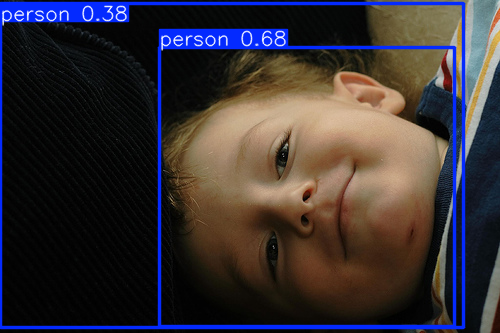

Displaying results after training:


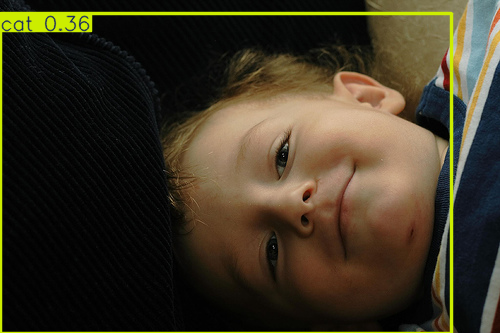


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_002682.jpg: 640x480 1 cat, 11.1ms
Speed: 3.4ms preprocess, 11.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_002682.jpg: 640x480 1 cat, 19.3ms
Speed: 2.7ms preprocess, 19.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 480)
Displaying results before training:


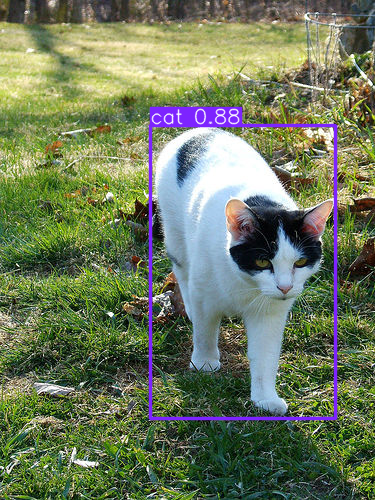

Displaying results after training:


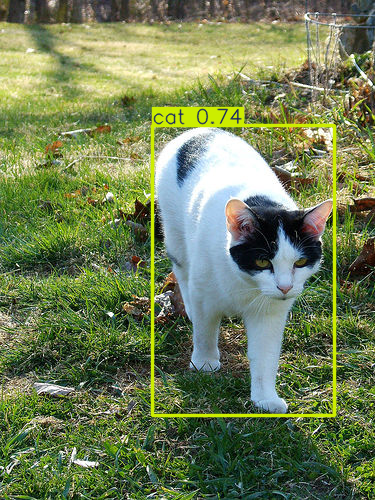


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_004347.jpg: 640x480 1 cat, 15.1ms
Speed: 4.8ms preprocess, 15.1ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_004347.jpg: 640x480 1 cat, 9.4ms
Speed: 2.8ms preprocess, 9.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)
Displaying results before training:


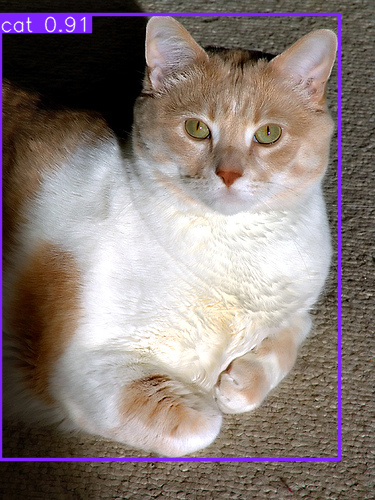

Displaying results after training:


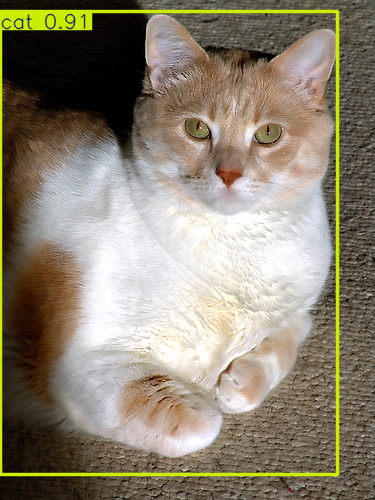


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2009_003157.jpg: 640x448 5 chairs, 1 couch, 1 potted plant, 1 tv, 11.5ms
Speed: 2.9ms preprocess, 11.5ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 448)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2009_003157.jpg: 640x448 4 chairs, 1 tvmonitor, 21.2ms
Speed: 2.6ms preprocess, 21.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 448)
Displaying results before training:


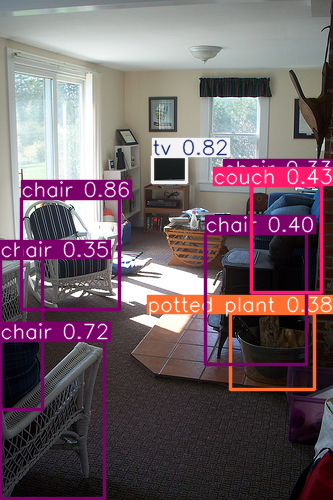

Displaying results after training:


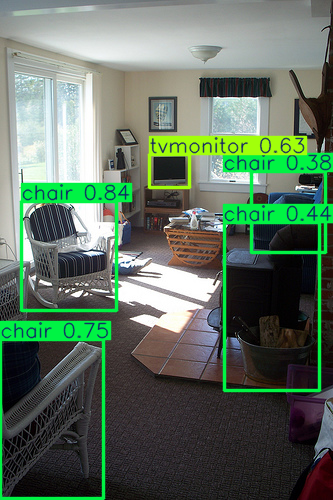


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2010_001456.jpg: 640x480 3 persons, 1 boat, 14.3ms
Speed: 3.0ms preprocess, 14.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2010_001456.jpg: 640x480 (no detections), 10.0ms
Speed: 2.3ms preprocess, 10.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
Displaying results before training:


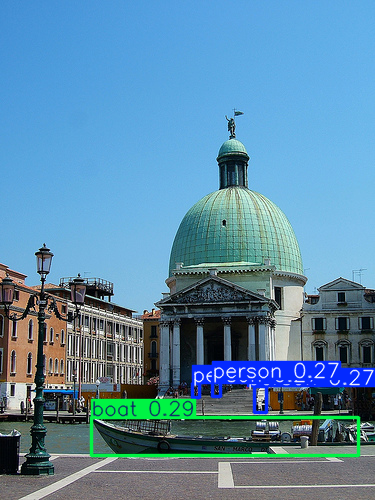

Displaying results after training:


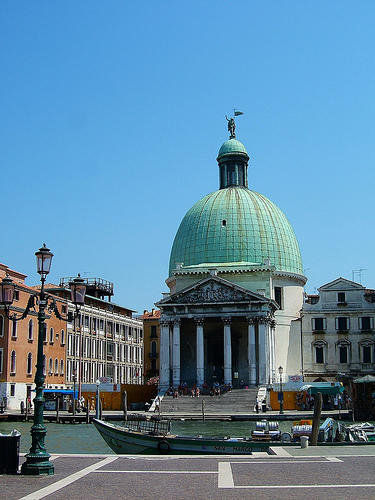


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_002778.jpg: 480x640 1 cow, 11.0ms
Speed: 4.7ms preprocess, 11.0ms inference, 4.8ms postprocess per image at shape (1, 3, 480, 640)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_002778.jpg: 480x640 1 cow, 63.8ms
Speed: 5.9ms preprocess, 63.8ms inference, 11.3ms postprocess per image at shape (1, 3, 480, 640)
Displaying results before training:


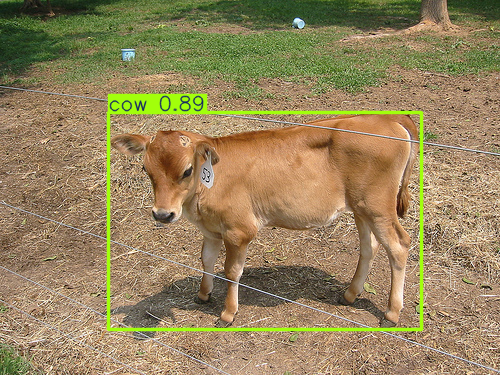

Displaying results after training:


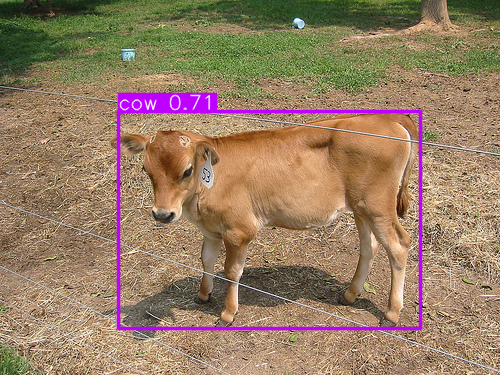


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_004797.jpg: 640x480 1 bench, 1 cat, 24.0ms
Speed: 6.3ms preprocess, 24.0ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_004797.jpg: 640x480 1 cat, 21.7ms
Speed: 7.4ms preprocess, 21.7ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)
Displaying results before training:


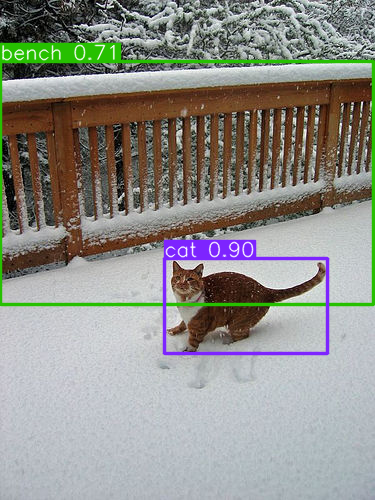

Displaying results after training:


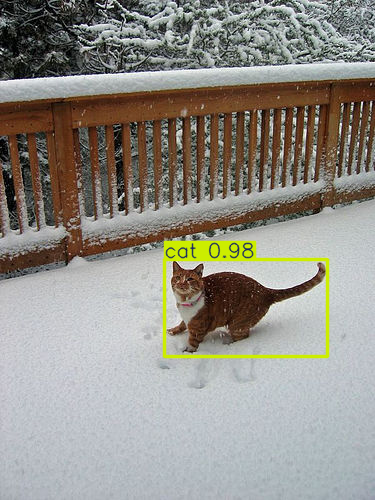


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_005812.jpg: 480x640 1 person, 1 bottle, 25.4ms
Speed: 9.2ms preprocess, 25.4ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2008_005812.jpg: 480x640 1 bottle, 1 person, 10.3ms
Speed: 4.6ms preprocess, 10.3ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)
Displaying results before training:


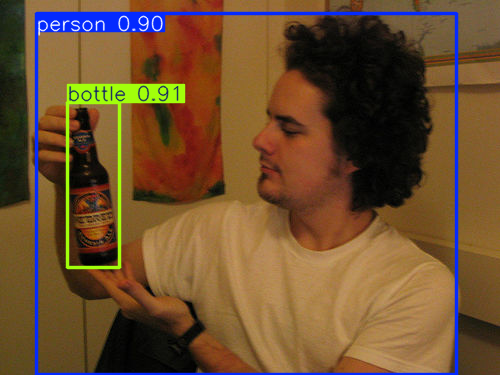

Displaying results after training:


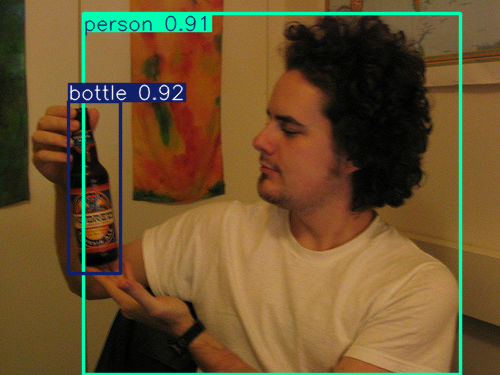


image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2009_001653.jpg: 640x448 1 dog, 45.2ms
Speed: 9.9ms preprocess, 45.2ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 448)

image 1/1 /content/VOCdevkit/VOC2012/JPEGImages/2009_001653.jpg: 640x448 (no detections), 21.0ms
Speed: 7.7ms preprocess, 21.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 448)
Displaying results before training:


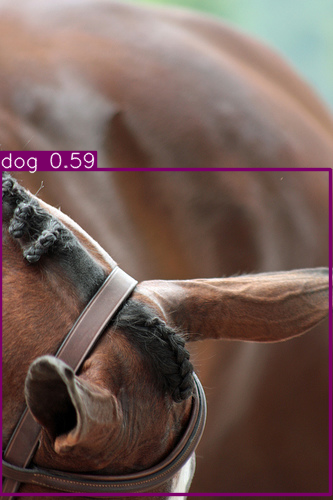

Displaying results after training:


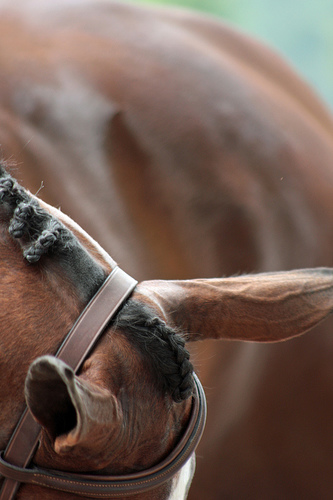

In [21]:
# Load the trained model weights for validation
model_after_training = YOLO("runs/train/exp/weights/best.pt")
# Function to compare model predictions
def compare_models(model_before, model_after, image_paths):
    for img_path in image_paths:
        # Predict with the model before training
        results_before = model_before.predict(img_path)
        img_before = results_before[0].plot()

        # Predict with the model after training
        results_after = model_after.predict(img_path)
        img_after = results_after[0].plot()

        # Display using OpenCV
        print("Displaying results before training:")
        cv2_imshow(img_before)
        cv2.waitKey(0)  # Wait for a key press to close the image window

        print("Displaying results after training:")
        cv2_imshow(img_after)
        cv2.waitKey(0)  # Wait for a key press to close the image window

    cv2.destroyAllWindows()

# Prepare a list of image paths for validation
sample_image_paths = []
for i in range(10):
    img_info = test_set[i]
    img_path = img_info[1]['annotation']['filename']
    full_img_path = os.path.join('/content/VOCdevkit/VOC2012/JPEGImages', img_path)
    sample_image_paths.append(full_img_path)

# Compare the models
compare_models(model_before_training, model_after_training, sample_image_paths)


# Model : FasterRCNN

In [ ]:
# Load the pretrained Faster R-CNN model
model_2 = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

# Set the model to evaluation mode
model_2.eval()

# Number of classes in the Pascal VOC dataset (20 classes + background)
num_classes = 21

# Get the input features of the classifier
in_features = model_2.roi_heads.box_predictor.cls_score.in_features

# Replace the head of the model
model_2.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Freeze all the layers in the backbone
for param in model_2.backbone.parameters():
    param.requires_grad = False

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:02<00:00, 75.1MB/s]


# Prediction

## Getting dataloaders

In [ ]:
# Define a custom collate function
def collate_fn(batch):
    return tuple(zip(*batch))

def get_dataloaders(train_set, test_set, transform, subset_size, val_size, batch_size):
    train_set.dataset.transform = transform
    test_set.dataset.transform = transform
    if subset_size:
        indices = torch.randperm(len(train_set))[:subset_size]
        train_subset = Subset(train_set, indices)
        train_size = int((1 - val_size) * subset_size)
        val_size = subset_size - train_size
        train_set, val_set = random_split(train_subset, [train_size, val_size])
    else:
        train_size = int((1 - val_size) * len(train_set))
        val_size = len(train_set) - train_size
        train_set, val_set = random_split(train_set, [train_size, val_size])

    train_loader = torch.utils.data.DataLoader(train_set, batch_size=batch_size, shuffle=True, num_workers=2, collate_fn=collate_fn)
    val_loader = torch.utils.data.DataLoader(val_set, batch_size=batch_size, shuffle=False, num_workers=2, collate_fn=collate_fn)
    test_loader = torch.utils.data.DataLoader(test_set, batch_size=batch_size, shuffle=False, num_workers=2, collate_fn=collate_fn)

    return train_loader, val_loader, test_loader

# Function to extract bounding boxes from target
def extract_boxes(target):
    boxes = []
    for obj in target['annotation']['object']:
        box = obj['bndbox']
        boxes.append([int(box['xmin']), int(box['ymin']), int(box['xmax']), int(box['ymax'])])
    return boxes

def visualize_predictions(image, target, prediction):

    fig, ax = plt.subplots(1, 2, figsize=(12, 6))

    # Ground truth
    ax[0].imshow(F.to_pil_image(image))
    for i, box in enumerate(extract_boxes(target)):
        ax[0].add_patch(plt.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                      fill=False, color='blue', linewidth=2))

        category_name = target['annotation']['object'][i]['name']
        ax[0].text(box[0], box[1] - 10, category_name, color='blue', fontsize=12, backgroundcolor='white')

    ax[0].set_title("Ground Truth")

    # Predictions
    ax[1].imshow(F.to_pil_image(image))
    for i, box in enumerate(prediction['boxes']):
        ax[1].add_patch(plt.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1],
                                      fill=False, color='red', linewidth=2))

        category_id = prediction['labels'][i].item()
        category_name = categories[category_id]
        ax[1].text(box[0], box[1] - 10, category_name, color='red', fontsize=12)

    ax[1].set_title("Predictions")

    plt.show()

In [ ]:
# Define the transform
transform = T.Compose([
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
subset_size = 1000
val_size = 0.2

train_loader, val_loader, test_loader = get_dataloaders(
                                            train_set = train_set,
                                            test_set = test_set,
                                            transform = transform,
                                            subset_size = subset_size,
                                            val_size = val_size,
                                            batch_size = 8)

## Evaluation before training

In [ ]:
# Function to apply NMS and filter predictions
def apply_nms(predictions, iou_threshold=0.5):
    # Perform Non-Maximum Suppression
    keep_indices = torchvision.ops.nms(predictions['boxes'], predictions['scores'], iou_threshold)
    predictions['boxes'] = predictions['boxes'][keep_indices]
    predictions['scores'] = predictions['scores'][keep_indices]
    predictions['labels'] = predictions['labels'][keep_indices]
    return predictions

def calculate_iou(box1, box2):
    # Calculate the (x, y)-coordinates of the intersection rectangle
    xA = max(box1[0], box2[0])
    yA = max(box1[1], box2[1])
    xB = min(box1[2], box2[2])
    yB = min(box1[3], box2[3])

    # Compute the area of intersection rectangle
    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)

    # Compute the area of both the prediction and ground-truth rectangles
    box1Area = (box1[2] - box1[0] + 1) * (box1[3] - box1[1] + 1)
    box2Area = (box2[2] - box2[0] + 1) * (box2[3] - box2[1] + 1)

    # Compute the intersection over union by taking the intersection
    # area and dividing it by the sum of prediction + ground-truth
    # areas - the intersection area
    iou = interArea / float(box1Area + box2Area - interArea)

    return iou

def evaluate_model(model, data_loader, device, iou_threshold, eval_batches):
    model.eval()
    total_true_positives = 0
    total_false_positives = 0
    total_false_negatives = 0
    batch_count = 0

    with torch.no_grad():
        for images, targets in data_loader:

            if batch_count >= eval_batches:
                break

            images = [image.to(device) for image in images]
            targets = [{k: v.to(device) if torch.is_tensor(v) else v for k, v in t.items()} for t in targets]

            # Make predictions
            predictions = model(images)

            for i in range(len(predictions)):
                # Apply NMS
                predictions[i] = apply_nms(predictions[i], iou_threshold)

                # Evaluate predictions
                pred_boxes = predictions[i]['boxes'].cpu()
                true_boxes = extract_boxes(targets[i])

                # Calculate true positives, false positives, false negatives
                for pred_box in pred_boxes:
                    if any([calculate_iou(pred_box, true_box) > iou_threshold for true_box in true_boxes]):
                        total_true_positives += 1
                    else:
                        total_false_positives += 1
                total_false_negatives += len(true_boxes) - total_true_positives

            print(f"{batch_count} / {eval_batches}")
            batch_count += 1

    precision = total_true_positives / (total_true_positives + total_false_positives)
    recall = total_true_positives / (total_true_positives + total_false_negatives)

    return precision, recall

In [ ]:
device = torch.device('cpu')
model_2.to(device)

precision_before, recall_before = evaluate_model(model_2, test_loader, device, iou_threshold=0.5, eval_batches=5)
print(f"Precision before training: {precision_before:.4f}, Recall before training: {recall_before:.4f}")


## Visualization before training

In [ ]:
device = torch.device('cpu')
model_2.to(device)

model_2.eval()
with torch.no_grad():
    for images, targets in test_loader:
        images = [image.to(device) for image in images]
        targets = [{k: v.to(device) if torch.is_tensor(v) else v for k, v in t.items()} for t in targets]

        # Make predictions
        predictions = model_2(images)

        # Apply NMS to the first image's predictions
        predictions[0] = apply_nms(predictions[0], iou_threshold=0.5)

        # Visualize predictions for the first image in the batch
        visualize_predictions(images[0], targets[0], predictions[0])

        # Stop after a few examples
        break

In [ ]:
import torch
import torchvision.transforms as T
import requests
from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from ultralytics import YOLO

def load_image_from_url(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content)).convert('RGB')
    return img

def preprocess_image(image):
    transform = T.Compose([
        T.Resize((640, 640)),
        T.ToTensor()
    ])
    return transform(image).unsqueeze(0)

# Load and preprocess the image
url = "https://ultralytics.com/images/bus.jpg"
original_image = load_image_from_url(url)
input_image = preprocess_image(original_image)

def visualize_detection(image, prediction, categories):
    fig, ax = plt.subplots(1)
    ax.imshow(image.permute(1, 2, 0))

    boxes = prediction['boxes'].cpu().numpy()
    scores = prediction['scores'].cpu().numpy()
    labels = prediction['labels'].cpu().numpy()

    for i, box in enumerate(boxes):
        xmin, ymin, xmax, ymax = box
        width = xmax - xmin
        height = ymax - ymin
        rect = patches.Rectangle((xmin, ymin), width, height, linewidth=1, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
        if int(labels[i]) < len(categories):
            category = categories[int(labels[i])]
            plt.text(xmin, ymin, f'{category}: {scores[i]:.2f}', color='white', fontsize=12, bbox=dict(facecolor='red', alpha=0.5))

    plt.show()

model_2.eval()
with torch.no_grad():

    # Make predictions
    predictions = model_2(input_image)

    # Visualize predictions
    visualize_detection(input_image[0].cpu(), predictions[0], categories)

## Training

In [ ]:
# Function to extract boxes and labels from target

def get_boxes_and_labels(target):
    boxes = []
    labels = []
    class_to_idx = {cls: idx for idx, cls in enumerate(categories)}
    for obj in target['annotation']['object']:
        box = obj['bndbox']
        boxes.append([int(box['xmin']), int(box['ymin']), int(box['xmax']), int(box['ymax'])])
        labels.append(class_to_idx[obj['name']])
    return {
        "boxes": torch.as_tensor(boxes, dtype=torch.float32),
        "labels": torch.as_tensor(labels, dtype=torch.int64)
    }

# Move model to device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model_2.to(device)

# Define training parameters
num_epochs = 10
learning_rate = 0.005
weight_decay = 0.0005

# Set up the optimizer
params = [p for p in model_2.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=learning_rate, momentum=0.9, weight_decay=weight_decay)

# Set up the learning rate scheduler
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)
lr_scheduler

# Training loop
loss_list = []
for epoch in range(num_epochs):
    model_2.train()
    i = 0
    epoch_loss = 0
    for images, targets in train_loader:
        # Move data to the appropriate device
        images = [image.to(device) for image in images]
        targets = [get_boxes_and_labels(t) for t in targets]
        targets = [{k: v.to(device) if isinstance(v, torch.Tensor) else v for k, v in t.items()} for t in targets]

        # Forward pass
        loss_dict = model_2(images, targets)

        # Compute losses
        losses = sum(loss for loss in loss_dict.values())

        # Backward pass
        optimizer.zero_grad()
        losses.backward()
        optimizer.step()
        epoch_loss += losses.item()

        if i % 10 == 0:
            print(f"Epoch [{epoch + 1}/{num_epochs}], Step [{i + 10}/{len(train_loader)}], Loss: {losses.item():.4f}")
        i += 1

    loss_list.append(epoch_loss / len(train_loader))
    # Update the learning rate
    lr_scheduler.step()
    torch.cuda.empty_cache()

print("Training complete.")

## Evaluation after training

In [ ]:
device = torch.device('cpu')
model_2.to(device)

precision_before, recall_before = evaluate_model(model_2, test_loader, device, iou_threshold=0.5, eval_batches=5)
print(f"Precision before training: {precision_before:.4f}, Recall before training: {recall_before:.4f}")


In [ ]:
device = torch.device('cpu')
model_2.to(device)

precision_after, recall_after = evaluate_model(model_2, test_loader, device, iou_threshold=0.5, eval_batches=5)
print(f"Precision after training: {precision_after:.4f}, Recall after training: {recall_after:.4f}")

## Visualization after training

In [ ]:
model_2.eval()
with torch.no_grad():
    for images, targets in test_loader:
        images = [image.to(device) for image in images]
        targets = [{k: v.to(device) if torch.is_tensor(v) else v for k, v in t.items()} for t in targets]

        # Make predictions
        predictions = model_2(images)

        # Apply NMS to the first image's predictions
        predictions[0] = apply_nms(predictions[0], iou_threshold=0.8)

        # Visualize predictions for the first image in the batch
        visualize_predictions(images[0], targets[0], predictions[0])

        # Stop after a few examples
        break

In [ ]:
model_2.eval()
with torch.no_grad():
    for images, targets in test_loader:
        images = [image.to(device) for image in images]
        targets = [{k: v.to(device) if torch.is_tensor(v) else v for k, v in t.items()} for t in targets]

        # Make predictions
        predictions = model_2(images)

        # Apply NMS to the first image's predictions
        predictions[0] = apply_nms(predictions[0], iou_threshold=0.1)

        # Visualize predictions for the first image in the batch
        visualize_predictions(images[0], targets[0], predictions[0])

        # Stop after a few examples
        break

In [ ]:
model_2.eval()
with torch.no_grad():
    for images, targets in test_loader:
        images = [image.to(device) for image in images]
        targets = [{k: v.to(device) if torch.is_tensor(v) else v for k, v in t.items()} for t in targets]

        # Make predictions
        predictions = model_2(images)

        # Apply NMS to the first image's predictions
        predictions[0] = apply_nms(predictions[0], iou_threshold=0.95)

        # Visualize predictions for the first image in the batch
        visualize_predictions(images[0], targets[0], predictions[0])

        # Stop after a few examples
        break